# Detectron2 Detect Microcontrollers
![detection example](https://github.com/TannerGilbert/Microcontroller-Detection-with-Detectron2/blob/master/doc/detection.png?raw=1)

<table align="left"><td>
  <a target="_blank"  href="https://colab.research.google.com/github/TannerGilbert/Microcontroller-Detection-with-Detectron2/blob/master/Detectron2_Detect_Microcontrollers.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab
  </a>
</td><td>
  <a target="_blank"  href="https://github.com/TannerGilbert/Microcontroller-Detection-with-Detectron2/blob/master/Detectron2_Detect_Microcontrollers.ipynb">
    <img width=32px src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
</td></table>

## Install detectron2

> **Important**: If you're running on a local machine, be sure to follow the [installation instructions](https://github.com/facebookresearch/detectron2/blob/master/INSTALL.md). This notebook includes only what's necessary to run in Colab.

In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html
# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

## Get data

In [2]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

Before we can start training our model we need to download our data-set. In this case we will use my microcontroller detection data-set, which is [available on Kaggle](https://www.kaggle.com/tannergi/microcontroller-detection).

In [3]:
# Install Kaggle API
!pip install -q kaggle
!pip install -q kaggle-cli

     |████████████████████████████████| 74 kB 2.8 MB/s 
     |████████████████████████████████| 4.2 MB 41.4 MB/s 
     |████████████████████████████████| 49 kB 7.9 MB/s 
     |████████████████████████████████| 141 kB 69.8 MB/s 
     |████████████████████████████████| 111 kB 71.9 MB/s 
  ERROR: Failed building wheel for lxml
    Running setup.py install for lxml ... error
ERROR: Command errored out with exit status 1: /usr/bin/python3 -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-q0sftg31/lxml_0d3a4a5d4d4440bdb35516c5567a4b39/setup.py'"'"'; __file__='"'"'/tmp/pip-install-q0sftg31/lxml_0d3a4a5d4d4440bdb35516c5567a4b39/setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' install --record /tmp/pip-record-okse_6k0/install-record.txt --s

If you are working in Colab you need to add the username and key contained in your kaggle.json file to your environment using os.

In [4]:
# only for google colab
import os
os.environ['KAGGLE_USERNAME'] = "<username>" 
os.environ['KAGGLE_KEY'] = "<key>"

In [5]:
!kaggle datasets download -d tannergi/microcontroller-detection

 60% 5.00M/8.34M [00:00<00:00, 33.4MB/s]
100% 8.34M/8.34M [00:00<00:00, 40.9MB/s]


In [6]:
!unzip microcontroller-detection.zip

Archive:  microcontroller-detection.zip
  inflating: Microcontroller Detection/test/IMG_20181228_102636.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102636.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102641.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102641.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102658.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102658.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102706.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102706.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102745.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102745.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102749.jpg  
  inflating: Microcontroller Detection/test/IMG_20181228_102749.xml  
  inflating: Microcontroller Detection/test/IMG_20181228_102757.jpg  
  inflating: Microcontroller Detection/test/IMG_20

In [7]:
!ls

'Microcontroller Detection'   microcontroller-detection.zip   sample_data


In [8]:
import pandas as pd

df = pd.read_csv('Microcontroller Detection/train_labels.csv')

df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_20181228_101826.jpg,800,600,Arduino_Nano,317,265,556,342
1,IMG_20181228_101855.jpg,800,600,Heltec_ESP32_Lora,398,243,592,382
2,IMG_20181228_101903.jpg,800,600,ESP8266,290,239,514,387
3,IMG_20181228_101915.jpg,800,600,Raspberry_Pi_3,194,200,669,531
4,IMG_20181228_102013.jpg,800,600,Arduino_Nano,383,336,591,444


## Register data-set

In order to use a dataset with Detectron2 we need to register it. For more information check out the [official documentation](https://detectron2.readthedocs.io/tutorials/datasets.html#register-a-dataset).

In [9]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools
import cv2

# write a function that loads the dataset into detectron2's standard format
def get_microcontroller_dicts(csv_file, img_dir):
    df = pd.read_csv(csv_file)
    df['filename'] = df['filename'].map(lambda x: img_dir+x)

    classes = ['Raspberry_Pi_3', 'Arduino_Nano', 'ESP8266', 'Heltec_ESP32_Lora']

    df['class_int'] = df['class'].map(lambda x: classes.index(x))

    dataset_dicts = []
    for idx, filename in enumerate(df['filename'].unique().tolist()):
        record = {}
        
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        objs = []
        for index, row in df[(df['filename']==filename)].iterrows():
          obj= {
              'bbox': [row['xmin'], row['ymin'], row['xmax'], row['ymax']],
              'bbox_mode': BoxMode.XYXY_ABS,
              'category_id': row['class_int'],
              "iscrowd": 0
          }
          objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [10]:
from detectron2.data import DatasetCatalog, MetadataCatalog

classes = ['Raspberry_Pi_3', 'Arduino_Nano', 'ESP8266', 'Heltec_ESP32_Lora']

for d in ["train", "test"]:
  DatasetCatalog.register('microcontroller/' + d, lambda d=d: get_microcontroller_dicts('Microcontroller Detection/' + d + '_labels.csv', 'Microcontroller Detection/' + d+'/'))
  MetadataCatalog.get('microcontroller/' + d).set(thing_classes=classes)
microcontroller_metadata = MetadataCatalog.get('microcontroller/train')

We can check if our code works correctly by plotting a few images.

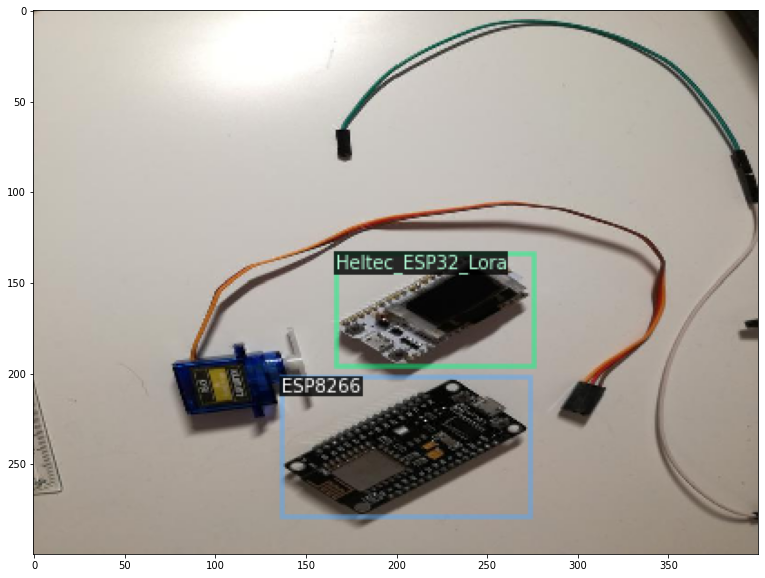

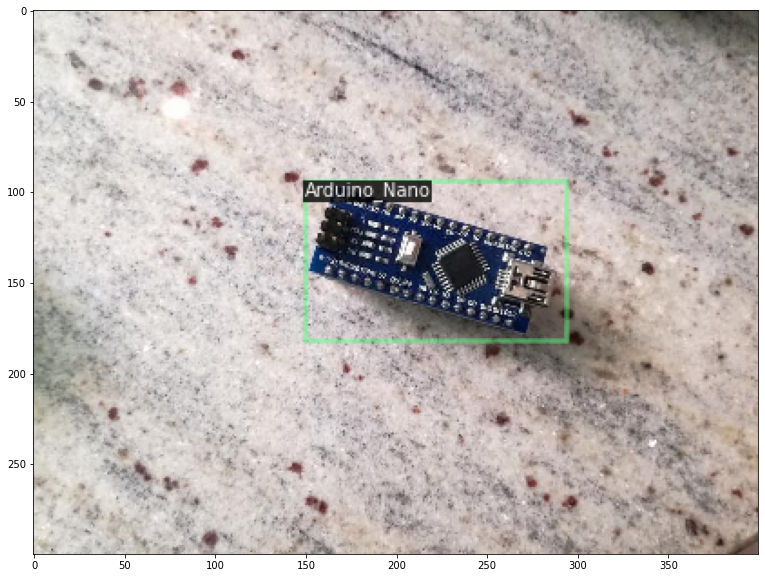

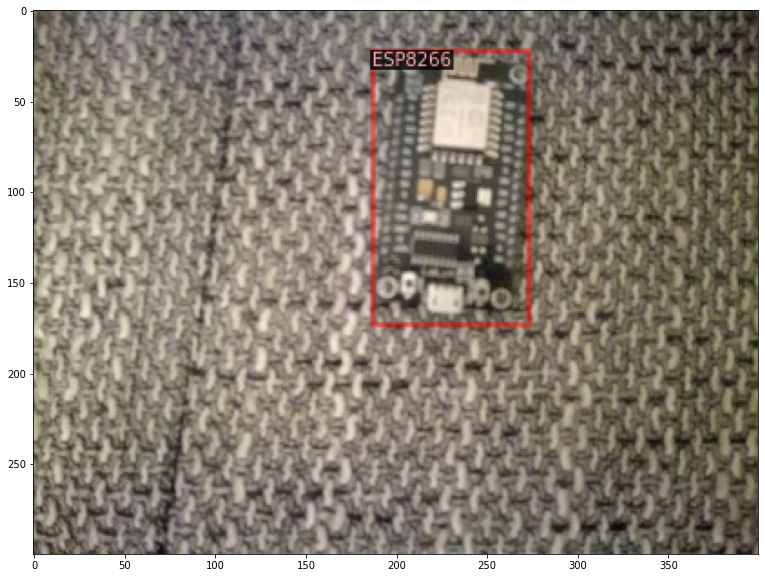

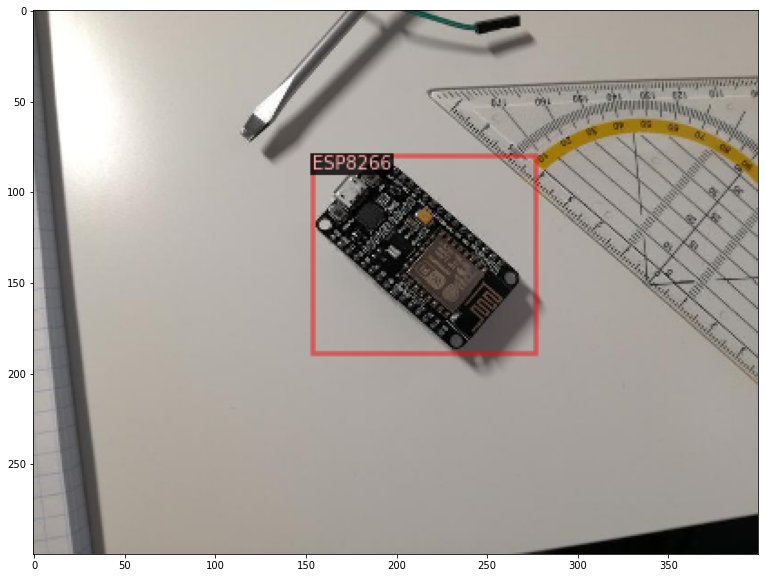

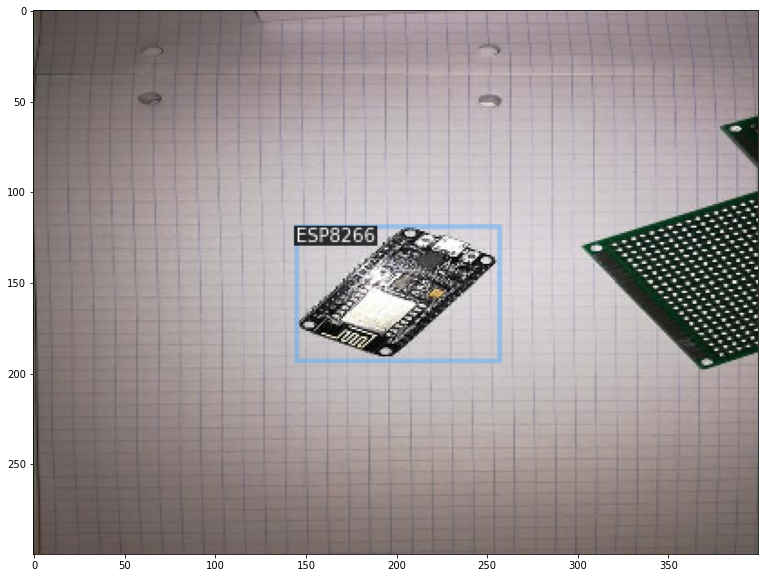

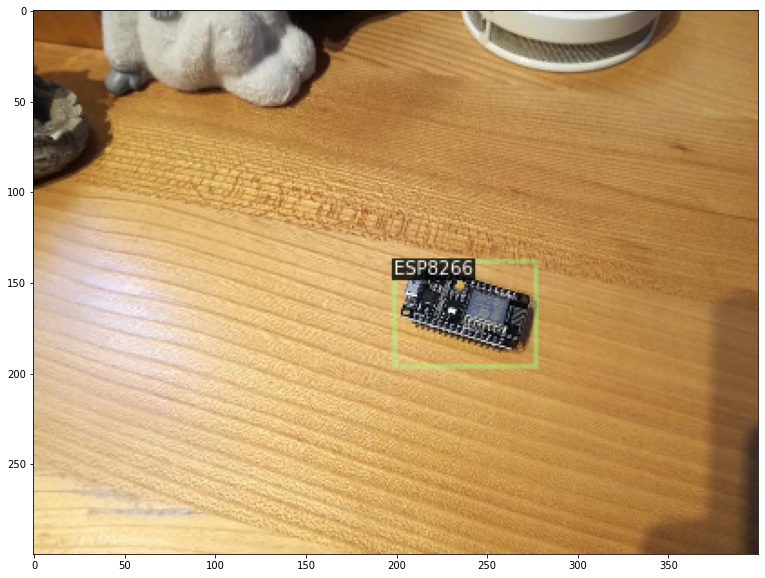

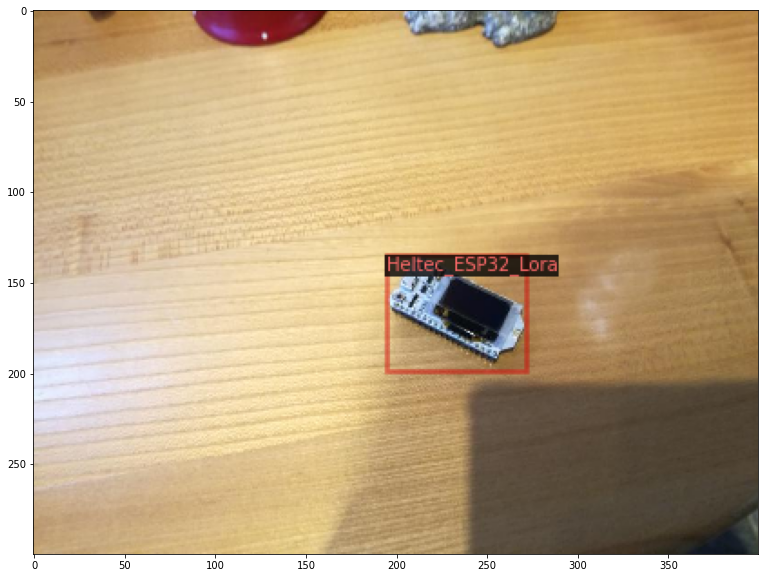

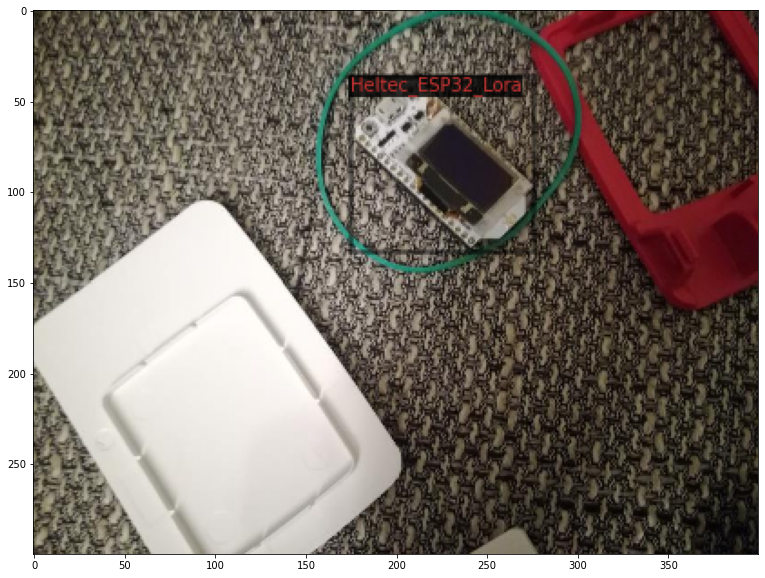

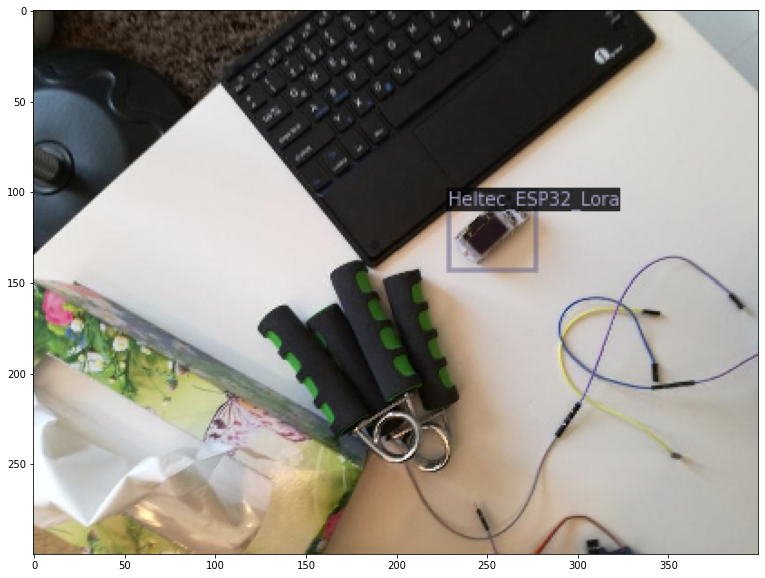

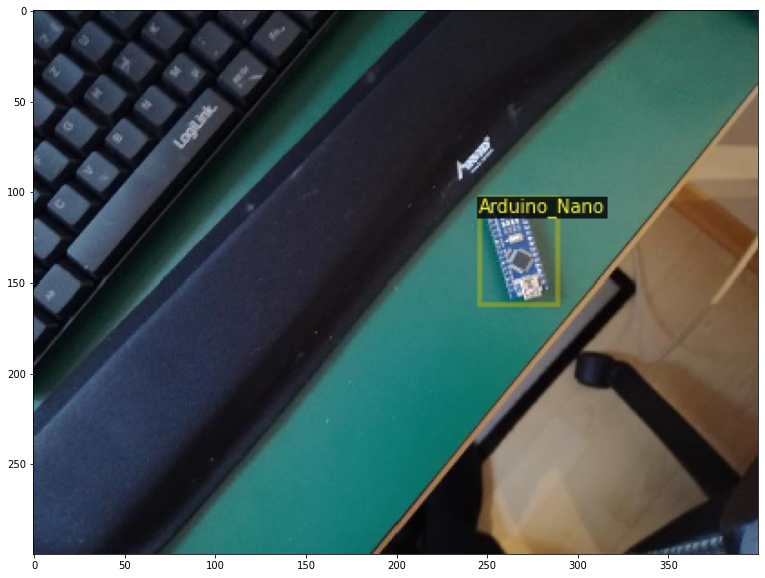

In [11]:
import random
from detectron2.utils.visualizer import Visualizer

dataset_dicts = DatasetCatalog.get('microcontroller/train')
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=microcontroller_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

## Train model

Now, let's fine-tune a pretrained FasterRCNN object detection model to detect the different microcontrollers.

In [12]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ('microcontroller/train',)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[08/13 09:15:59 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:05, 47.6MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_p

[08/13 09:16:07 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[08/13 09:16:19 d2.utils.events]:  eta: 0:09:17  iter: 19  total_loss: 1.102  loss_cls: 0.9691  loss_box_reg: 0.1384  loss_rpn_cls: 0.001866  loss_rpn_loc: 0.002823  time: 0.5783  data_time: 0.0189  lr: 0.00039962  max_mem: 3207M
[08/13 09:16:31 d2.utils.events]:  eta: 0:09:25  iter: 39  total_loss: 0.3641  loss_cls: 0.1859  loss_box_reg: 0.1588  loss_rpn_cls: 0.002363  loss_rpn_loc: 0.002707  time: 0.5956  data_time: 0.0077  lr: 0.00079922  max_mem: 3207M
[08/13 09:16:43 d2.utils.events]:  eta: 0:09:13  iter: 59  total_loss: 0.3145  loss_cls: 0.1299  loss_box_reg: 0.1661  loss_rpn_cls: 0.001103  loss_rpn_loc: 0.002234  time: 0.5976  data_time: 0.0080  lr: 0.0011988  max_mem: 3207M
[08/13 09:16:55 d2.utils.events]:  eta: 0:09:03  iter: 79  total_loss: 0.3111  loss_cls: 0.1265  loss_box_reg: 0.1815  loss_rpn_cls: 0.0008412  loss_rpn_loc: 0.002706  time: 0.5973  data_time: 0.0083  lr: 0.0015984  max_mem: 3207M
[08/13 09:17:08 d2.utils.events]:  eta: 0:08:58  iter: 99  total_loss: 0.2902 

## Use model for inference

Now, we can perform inference on our validation set by creating a predictor object.

In [13]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set the testing threshold for this model
cfg.DATASETS.TEST = ('microcontroller/test', )
predictor = DefaultPredictor(cfg)

In [14]:
df_test = pd.read_csv('Microcontroller Detection/test_labels.csv')
df_test

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_20181228_102636.jpg,800,600,ESP8266,316,205,465,313
1,IMG_20181228_102641.jpg,800,600,Heltec_ESP32_Lora,401,251,553,405
2,IMG_20181228_102658.jpg,800,600,Arduino_Nano,184,130,618,330
3,IMG_20181228_102706.jpg,800,600,Raspberry_Pi_3,233,137,640,472
4,IMG_20181228_102745.jpg,800,600,Heltec_ESP32_Lora,195,135,609,366
5,IMG_20181228_102749.jpg,800,600,Arduino_Nano,158,179,540,372
6,IMG_20181228_102757.jpg,800,600,ESP8266,266,215,658,443


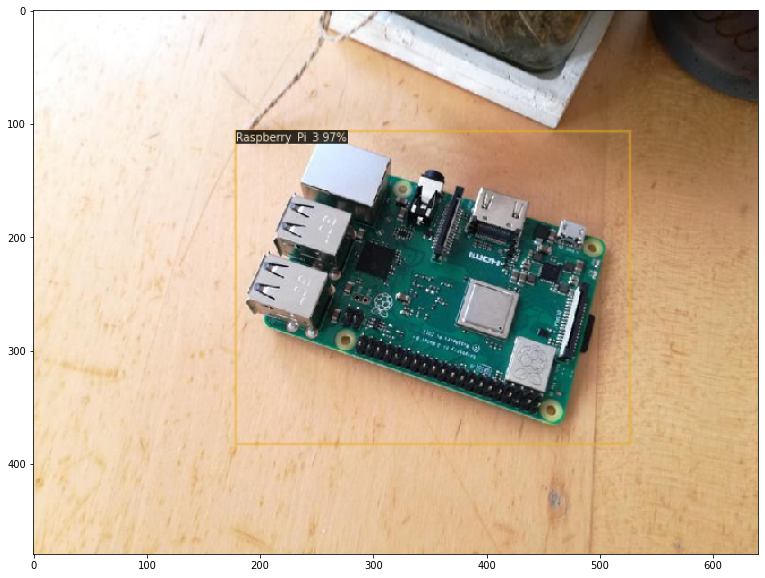

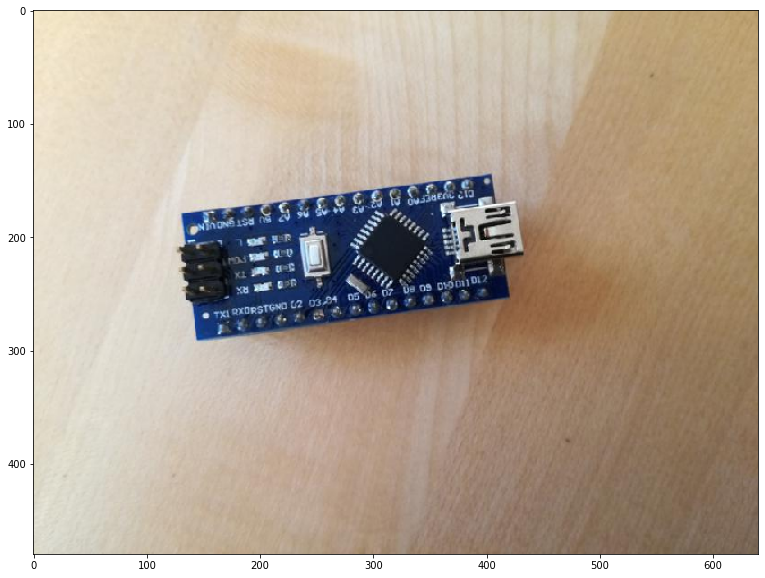

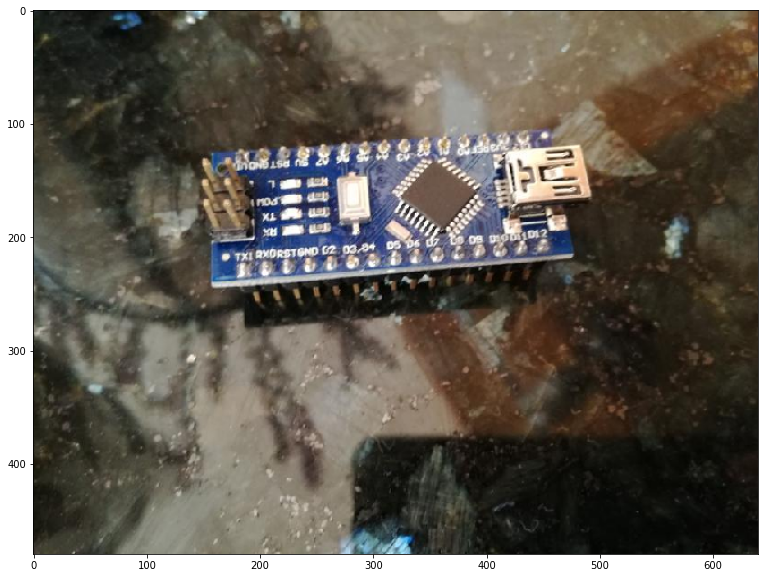

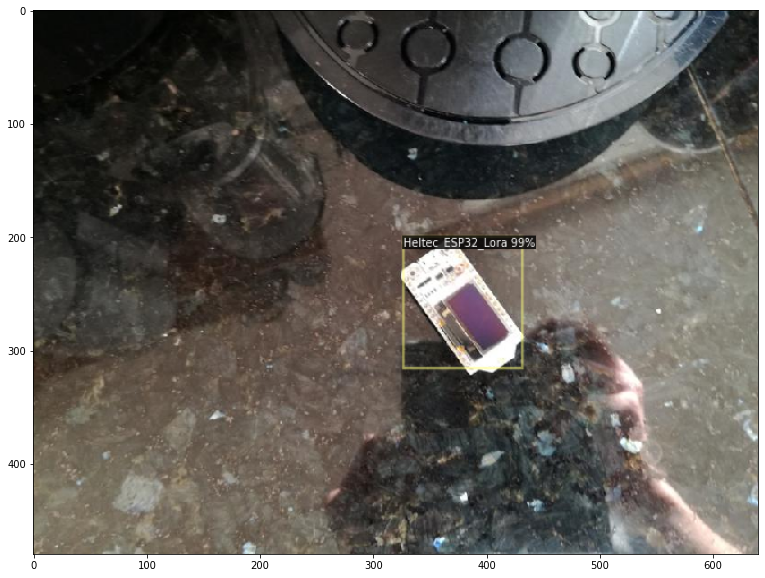

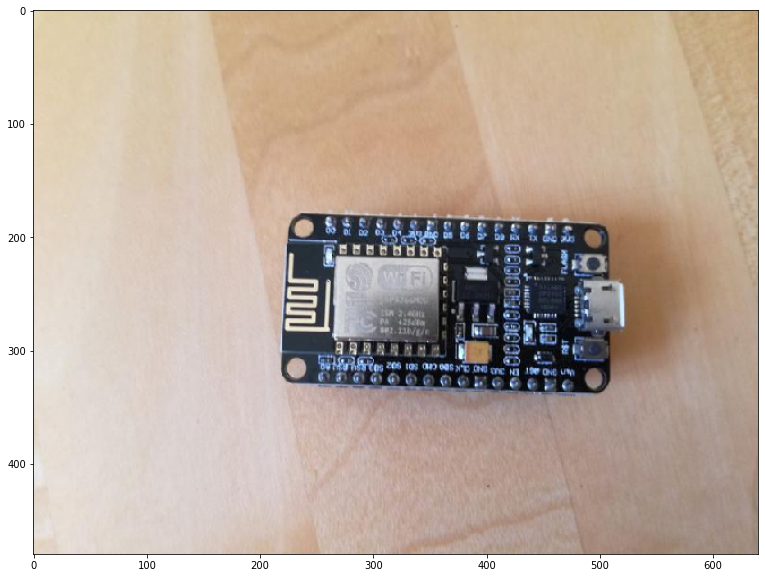

In [15]:
from detectron2.utils.visualizer import ColorMode
import random

dataset_dicts = DatasetCatalog.get('microcontroller/test')
for d in random.sample(dataset_dicts, 5):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1], metadata=microcontroller_metadata, scale=0.8)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [16]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>